In [1]:
import cv2
import dlib
import numpy as np
from skimage import io
import matplotlib.pylab as plt
from scipy.spatial import Delaunay

%matplotlib inline

## Part 1 : Image Morphing using tiepoints given through file

In [102]:
file = open("tiepoints.txt")

lines = file.readlines()

n = 0

tri_points = []

for index, line in enumerate(lines):
    if index == 0:
        n = int(line.strip())
    else:
        point = line.strip().split(" ")
        point = [int(elm) for elm in point]
        tri_points.append(point)
        
vec1 = np.empty([n,2], dtype = int)
vec2 = np.empty([n,2], dtype = int)
        
for i in range(n):
    vec1[i][0] = tri_points[i][0]
    vec1[i][1] = tri_points[i][1]
    vec2[i][0] = tri_points[i][2]
    vec2[i][1] = tri_points[i][3]

88
88


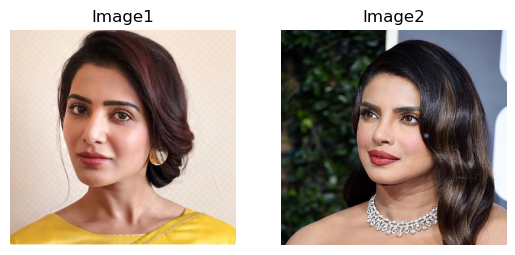

In [92]:
img1 = cv2.imread('Images/Lab2/img1.jpg', cv2.IMREAD_COLOR)
img2 = cv2.imread('Images/Lab2/img21.jpg', cv2.IMREAD_COLOR)
img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB)
img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2RGB)

plt.subplot(121, title="Image1")
plt.imshow(img1)
plt.axis('off')
plt.subplot(122, title="Image2")
plt.imshow(img2)
plt.axis('off')
plt.show()

In [93]:
# Triangulation of image1 with co-ordinates read from file
tri1 = Delaunay(vec1)

In [94]:
# All triangulars coordinates for image1 stored in 'img1_triangles' variable
img1_triangles =  vec1[tri1.simplices]
img1_triangles = np.array(img1_triangles)

In [95]:
#Function for finding 'index' of the co-ordinates used in the triangle in image1 
def find_idx_of_point(vec1, t):
    for i in range(88):
        if vec1[i,0] == t[0] and vec1[i,1] == t[1]:
            return i

In [105]:
# Triangulation of image2 according to image1
tri_len = len(img1_triangles)

img2_triangles = np.ones((tri_len,3,2))

for i in range(tri_len):
    t = img1_triangles[i];
    row = []
    for j in range(3):
        idx = find_idx_of_point(vec1, t[j])
        row = vec2[idx]
        img2_triangles[i][j][0] = row[0]
        img2_triangles[i][j][1] = row[1]      

In [106]:
# Facial feature of intermediate image using formula  (x,y) = (1-alpha)(x,y) + alpha(x,y)

def get_facial_features_landmarks(vec1, vec2, alpha):
    vec3 = np.empty([88,2], dtype = int)

    for i in range(82):
        x1,y1 = vec1[i]
        x2,y2 = vec2[i]
        x = int((1-alpha)*x1 + alpha*x2)
        y = int((1-alpha)*y1 + alpha*y2)
        vec3[i][0] = x
        vec3[i][1] = y

    vec3[82][0], vec3[82][1] = vec1[82][0], vec1[82][1]
    vec3[83][0], vec3[83][1] = vec1[83][0], vec1[83][1]
    vec3[84][0], vec3[84][1] = vec1[84][0], vec1[84][1]
    vec3[85][0], vec3[85][1] = vec1[85][0], vec1[85][1]
    vec3[86][0], vec3[86][1] = vec1[86][0], vec1[86][1]
    vec3[87][0], vec3[87][1] = vec1[87][0], vec1[87][1]

    
    return vec3

In [114]:
# Triangulation of intermediate image

def get_triangles_morphed_img(vec1, vec3, img1_triangles):
    tri_len = len(img1_triangles)

    morphed_triangles = np.ones((tri_len,3,2))

    for i in range(tri_len):
        t = img1_triangles[i];
        row = []
        for j in range(3):
            idx = find_idx_of_point(vec1, t[j])
#             print(f"idx = {idx}")
            row = vec3[idx]
            morphed_triangles[i][j][0] = row[0]
            morphed_triangles[i][j][1] = row[1]    
    
    return morphed_triangles 

In [115]:
# Given image1, image2, and alpha , we will take each triangle from image1 and image2 and fill the intermediate triangle 
# with respect to image1 and image2

def morph_triangle(img1, img2, alpha) :
    img = np.zeros(img1.shape, dtype=img1.dtype)
       
    for i in range(len(img1_triangles)):
        triangle1 = img1_triangles[i]
        triangle2 = img2_triangles[i]
        triangle3 =  morphed_triangles[i]
    
        # Rectangle that bound the triangles of image1, image2, and morphed image
        rect1 = cv2.boundingRect(np.float32([triangle1]))
        t1Rect = []
        
        for i in range(0,3):
            t1Rect.append(((triangle1[i][0] - rect1[0]),(triangle1[i][1] - rect1[1])))
            
        rect2 = cv2.boundingRect(np.float32([triangle2]))
        t2Rect = []
        
        for i in range(0,3):
            t2Rect.append(((triangle2[i][0] - rect2[0]),(triangle2[i][1] - rect2[1])))
                     
        rect = cv2.boundingRect(np.float32([triangle3]))
        tRect = []
        
        for i in range(0, 3):
            tRect.append(((triangle3[i][0] - rect[0]),(triangle3[i][1] - rect[1])))
            
       
        # Create mask of size rectangle bounding triangle of morphed image
        mask = np.zeros((rect[3], rect[2],3), dtype = np.float32)
        cv2.fillConvexPoly(mask, np.int32(tRect), (1.0, 1.0, 1.0), 16, 0)

        # Extract the image of size rectangle bounding triangles
        img1Rect = img1[rect1[1]:rect1[1] + rect1[3], rect1[0]:rect1[0] + rect1[2]]
        img2Rect = img2[rect2[1]:rect2[1] + rect2[3], rect2[0]:rect2[0] + rect2[2]]

        size = (rect[2], rect[3])
        
        warpMat = cv2.getAffineTransform(np.float32(t1Rect), np.float32(tRect))
        warpAffineImage1 = cv2.warpAffine(img1Rect, warpMat, (rect[2], rect[3]), None, flags=cv2.INTER_LINEAR, borderMode=cv2.BORDER_REFLECT_101)
        warpMat = cv2.getAffineTransform(np.float32(t2Rect), np.float32(tRect))
        warpAffineImage2 = cv2.warpAffine(img2Rect, warpMat, (rect[2], rect[3]), None, flags=cv2.INTER_LINEAR, borderMode=cv2.BORDER_REFLECT_101)
        
        imgRect = (1.0 - alpha) * warpAffineImage1 + alpha * warpAffineImage2    
        img[rect[1]:rect[1]+rect[3], rect[0]:rect[0]+rect[2]] = img[rect[1]:rect[1]+rect[3], rect[0]:rect[0]+rect[2]] * ( 1 - mask ) + imgRect * mask
    
    return img

In [116]:
# With respect to different alpha, we will get an intermediate image. I have take 20 intermediate image

images = []

for alpha in range(0,20):
    vec3 = get_facial_features_landmarks(vec1,vec2,alpha*0.05)
    morphed_triangles = get_triangles_morphed_img(vec1, vec3, img1_triangles)
    image = morph_triangle(img1, img2, alpha*0.05)
    plt.save
    images.append(image)
    
# images = np.array(images)

In [118]:
# Creating GIF

from moviepy.editor import ImageSequenceClip
clip = ImageSequenceClip(list(images), fps=100)
clip.write_gif('morphed1.gif', fps=200)

MoviePy - Building file morphed1.gif with imageio.


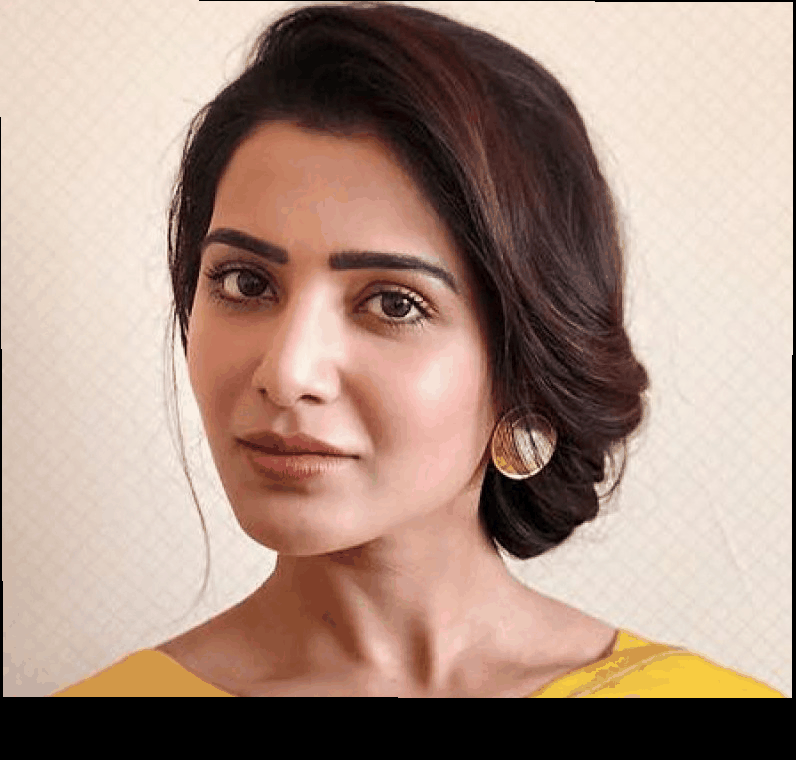

In [119]:
from IPython.display import Image
Image(filename="morphed.gif")

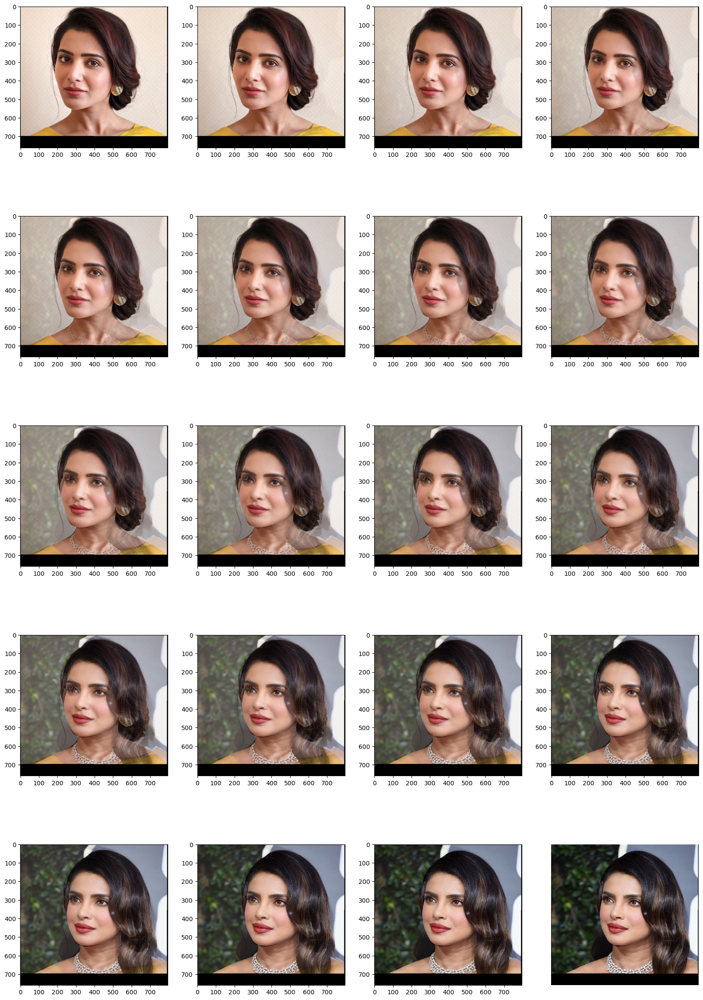

In [120]:
images = np.array(images)
plt.figure(figsize=(20,30))
for i in range(20):
    plt.subplot(5,4,i+1)
    plt.imshow(images[i])

plt.axis('off') 
plt.show()

## Part 2 - Image Morphing by detecting facial feature

In [2]:
# Dlib library for detecting facial features
detector = dlib.get_frontal_face_detector()
predictor = dlib.shape_predictor("shape_predictor_68_face_landmarks.dat")

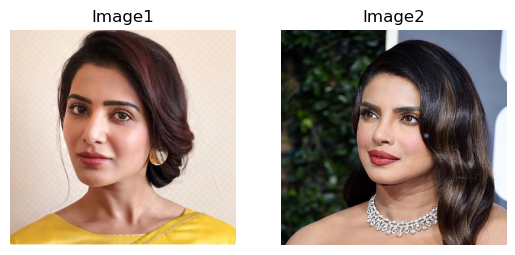

In [121]:
img1 = cv2.imread('Images/Lab2/img1.jpg', cv2.IMREAD_COLOR)
img2 = cv2.imread('Images/Lab2/img21.jpg', cv2.IMREAD_COLOR)
img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB)
img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2RGB)

plt.subplot(121, title="Image1")
plt.imshow(img1)
plt.axis('off')
plt.subplot(122, title="Image2")
plt.imshow(img2)
plt.axis('off')
plt.show()

In [122]:
# finding coordinates of facial features

dets1 = detector(img1)
dets2 = detector(img2)

for k, d in enumerate(dets1):
    shape1 = predictor(img1, d)
    
for k, d in enumerate(dets2):  
    shape2 = predictor(img2, d)
    
vec1 = np.empty([97,2], dtype = int)
vec2 = np.empty([97,2], dtype = int)

for b in range(68):
    vec1[b][0] = shape1.part(b).x
    vec1[b][1] = shape1.part(b).y
    vec2[b][0] = shape2.part(b).x
    vec2[b][1] = shape2.part(b).y   
    
h,w,ch = img1.shape    

#hair
vec1[68][0], vec1[68][1] = 379,7 
vec1[69][0], vec1[69][1] = 258,57 
vec1[70][0], vec1[70][1] = 210,105 
vec1[71][0], vec1[71][1] = 491,295
vec1[72][0], vec1[72][1] = 504,339
vec1[73][0], vec1[73][1] = 489,483
vec1[74][0], vec1[74][1] = 544,67
vec1[75][0], vec1[75][1] = 614,213
vec1[76][0], vec1[76][1] = 624,311
vec1[77][0], vec1[77][1] = 555,351
vec1[78][0], vec1[78][1] = 579,526

#head
vec1[79][0], vec1[79][1] = 326,129
vec1[80][0], vec1[80][1] = 375,139
vec1[81][0], vec1[81][1] = 421,188
vec1[82][0], vec1[82][1] = 468,260
vec1[83][0], vec1[83][1] = 263,126
vec1[84][0], vec1[84][1] = 230,156
vec1[85][0], vec1[85][1] = 214,184

#neck
vec1[86][0], vec1[86][1] = 273,575
vec1[87][0], vec1[87][1] = 253,595
vec1[88][0], vec1[88][1] = 172,640
vec1[89][0], vec1[89][1] = 358,637

#corners
vec1[90][0], vec1[90][1] = 0,0
vec1[91][0], vec1[91][1] = w-5,0
vec1[92][0], vec1[92][1] = w-5,h-5
vec1[93][0], vec1[93][1] = 0,h-5
vec1[94][0], vec1[94][1] = 787, 367
vec1[95][0], vec1[95][1] = 373, 697
vec1[96][0], vec1[96][1] = 5,367


#hair
vec2[68][0], vec2[68][1] = 472,38
vec2[69][0], vec2[69][1] = 374,75 
vec2[70][0], vec2[70][1] = 311,127 
vec2[71][0], vec2[71][1] = 484,344
vec2[72][0], vec2[72][1] = 539,444
vec2[73][0], vec2[73][1] = 562,485
vec2[74][0], vec2[74][1] = 644,133
vec2[75][0], vec2[75][1] = 708,272
vec2[76][0], vec2[76][1] = 725,363
vec2[77][0], vec2[77][1] = 619,369
vec2[78][0], vec2[78][1] = 680,535

#head
vec2[79][0], vec2[79][1] = 389,162
vec2[80][0], vec2[80][1] = 441,171
vec2[81][0], vec2[81][1] = 489,214
vec2[82][0], vec2[82][1] = 492,258
vec2[83][0], vec2[83][1] = 327,165
vec2[84][0], vec2[84][1] = 304,192
vec2[85][0], vec2[85][1] = 283,231

#neck
vec2[86][0], vec2[86][1] = 333,575
vec2[87][0], vec2[87][1] = 308,601
vec2[88][0], vec2[88][1] = 204,642
vec2[89][0], vec2[89][1] = 401,610

#corners
vec2[90][0], vec2[90][1] = 0,0
vec2[91][0], vec2[91][1] = w-5,0
vec2[92][0], vec2[92][1] = w-5,h-5
vec2[93][0], vec2[93][1] = 0,h-5
vec2[94][0], vec2[94][1] = 787, 367
vec2[95][0], vec2[95][1] = 373, 697
vec2[96][0], vec2[96][1] = 5,367

In [123]:
# Triangulation of image1 with co-ordinates obtained from dlib shape predictor
tri1 = Delaunay(vec1)

In [124]:
# All triangulars coordinates for image1 stored in 'img1_triangles' variable
img1_triangles =  vec1[tri1.simplices]
img1_triangles = np.array(img1_triangles)

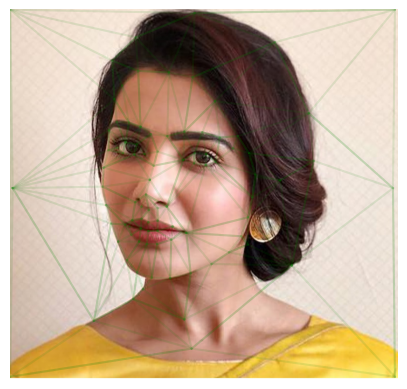

In [125]:
plt.imshow(img1)
for triangle in img1_triangles:
    x,y = zip(*triangle)
    plt.plot(x,y,'g-', alpha=0.1)

plt.axis('off')
plt.show()

In [126]:
#Function for finding 'index' of the co-ordinates used in the triangle in image1 
def find_idx_of_point(vec1, t):
    for i in range(97):
        if vec1[i,0] == t[0] and vec1[i,1] == t[1]:
            return i

In [127]:
n = len(img1_triangles)

img2_triangles = np.ones((n,3,2))

for i in range(n):
    t = img1_triangles[i];
    row = []
    for j in range(3):
        idx = find_idx_of_point(vec1, t[j])
        row = vec2[idx]
        img2_triangles[i][j][0] = row[0]
        img2_triangles[i][j][1] = row[1]       

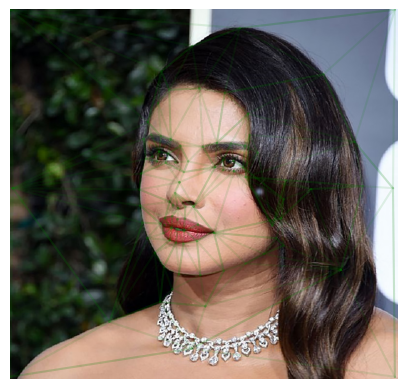

In [128]:
plt.imshow(img2)
for triangle in img2_triangles:
    x,y = zip(*triangle)
    plt.plot(x,y,'g-', alpha=0.1)

plt.axis('off')
plt.show()

### Drawing triangles present at index 4 to check whether triangles are one to one correspondence

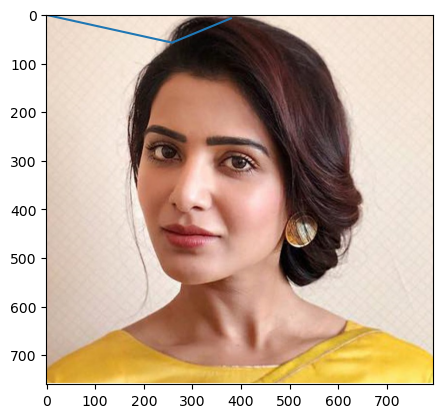

In [129]:
first_tri1 = img1_triangles[4]
first_tri2 = img2_triangles[4]

XX = first_tri1[:,0]
YY = first_tri1[:,1]

plt.imshow(img1)
plt.plot(XX,YY)
plt.show()

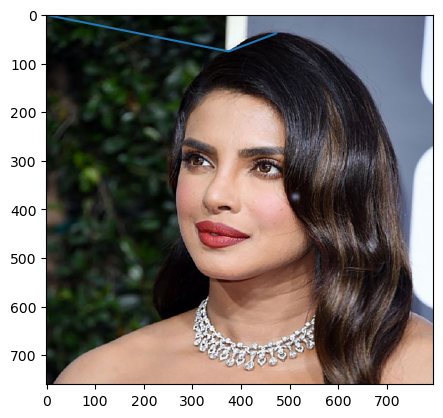

In [130]:
XX = first_tri2[:,0]
YY = first_tri2[:,1]

plt.imshow(img2)
plt.plot(XX,YY)
plt.show()

In [131]:
print(len(img1_triangles))
print(len(img2_triangles))

186
186


### Make array for coordinates of facial feature in the intermediate morphed image

In [132]:
def get_facial_features_landmarks(vec1, vec2, alpha):
    vec3 = np.empty([97,2], dtype = int)

    for i in range(90):
        x1,y1 = vec1[i]
        x2,y2 = vec2[i]
        x = int((1-alpha)*x1 + alpha*x2)
        y = int((1-alpha)*y1 + alpha*y2)
        vec3[i][0] = x
        vec3[i][1] = y

    vec3[90][0], vec3[90][1] = vec1[90][0], vec1[90][1]
    vec3[91][0], vec3[91][1] = vec1[91][0], vec1[91][1]
    vec3[92][0], vec3[92][1] = vec1[92][0], vec1[92][1]
    vec3[93][0], vec3[93][1] = vec1[93][0], vec1[93][1]
    vec3[94][0], vec3[94][1] = vec1[94][0], vec1[94][1]
    vec3[95][0], vec3[95][1] = vec1[95][0], vec1[95][1]
    vec3[96][0], vec3[96][1] = vec1[96][0], vec1[96][1]
    
    return vec3

In [133]:
def get_triangles_morphed_img(vec1, vec3, img1_triangles):
    n = len(img1_triangles)

    morphed_triangles = np.ones((n,3,2))

    for i in range(n):
        t = img1_triangles[i];
        row = []
        for j in range(3):
            idx = find_idx_of_point(vec1, t[j])
            row = vec3[idx]
            morphed_triangles[i][j][0] = row[0]
            morphed_triangles[i][j][1] = row[1]    
    
    return morphed_triangles        

In [134]:
print(img1.shape)
print(img2.shape)

(760, 796, 3)
(760, 796, 3)


In [135]:
# Given image1, image2, and alpha , we will take each triangle from image1 and image2 and fill the intermediate triangle 
# with respect to image1 and image2


def morph_triangle(img1, img2, alpha) :
    img = np.zeros(img1.shape, dtype=img1.dtype)
       
    for i in range(len(img1_triangles)):
        triangle1 = img1_triangles[i]
        triangle2 = img2_triangles[i]
        triangle3 =  morphed_triangles[i]
    
        # Rectangle that bound the triangles of image1, image2, and morphed image
        rect1 = cv2.boundingRect(np.float32([triangle1]))
        t1Rect = []
        
        for i in range(0,3):
            t1Rect.append(((triangle1[i][0] - rect1[0]),(triangle1[i][1] - rect1[1])))
            
        rect2 = cv2.boundingRect(np.float32([triangle2]))
        t2Rect = []
        
        for i in range(0,3):
            t2Rect.append(((triangle2[i][0] - rect2[0]),(triangle2[i][1] - rect2[1])))
                     
        rect = cv2.boundingRect(np.float32([triangle3]))
        tRect = []
        
        for i in range(0, 3):
            tRect.append(((triangle3[i][0] - rect[0]),(triangle3[i][1] - rect[1])))
            
       
        # Create mask of size rectangle bounding triangle of morphed image
        mask = np.zeros((rect[3], rect[2],3), dtype = np.float32)
        cv2.fillConvexPoly(mask, np.int32(tRect), (1.0, 1.0, 1.0), 16, 0)

        # Extract the image of size rectangle bounding triangles
        img1Rect = img1[rect1[1]:rect1[1] + rect1[3], rect1[0]:rect1[0] + rect1[2]]
        img2Rect = img2[rect2[1]:rect2[1] + rect2[3], rect2[0]:rect2[0] + rect2[2]]

        size = (rect[2], rect[3])
        
        warpMat = cv2.getAffineTransform(np.float32(t1Rect), np.float32(tRect))
        warpAffineImage1 = cv2.warpAffine(img1Rect, warpMat, (rect[2], rect[3]), None, flags=cv2.INTER_LINEAR, borderMode=cv2.BORDER_REFLECT_101)
        warpMat = cv2.getAffineTransform(np.float32(t2Rect), np.float32(tRect))
        warpAffineImage2 = cv2.warpAffine(img2Rect, warpMat, (rect[2], rect[3]), None, flags=cv2.INTER_LINEAR, borderMode=cv2.BORDER_REFLECT_101)
        
        imgRect = (1.0 - alpha) * warpAffineImage1 + alpha * warpAffineImage2    
        img[rect[1]:rect[1]+rect[3], rect[0]:rect[0]+rect[2]] = img[rect[1]:rect[1]+rect[3], rect[0]:rect[0]+rect[2]] * ( 1 - mask ) + imgRect * mask
    
    return img

In [136]:
# With respect to different alpha, we will get an intermediate image. I have take 20 intermediate image

images = []

for alpha in range(0,20):
    vec3 = get_facial_features_landmarks(vec1,vec2,alpha*0.05)
    morphed_triangles = get_triangles_morphed_img(vec1, vec3, img1_triangles)
    image = morph_triangle(img1, img2, alpha*0.05)
    plt.save
    images.append(image)
    
# images = np.array(images)

In [137]:
from moviepy.editor import ImageSequenceClip
clip = ImageSequenceClip(list(images), fps=100)
clip.write_gif('morphed2.gif', fps=200)

MoviePy - Building file morphed2.gif with imageio.


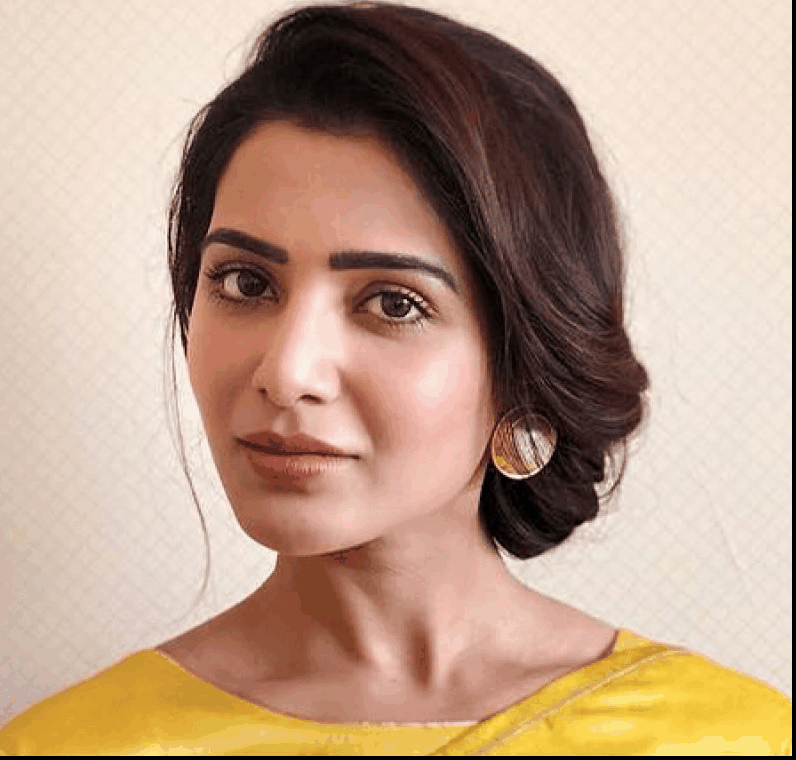

In [138]:
from IPython.display import Image
Image(filename="morphed2.gif")

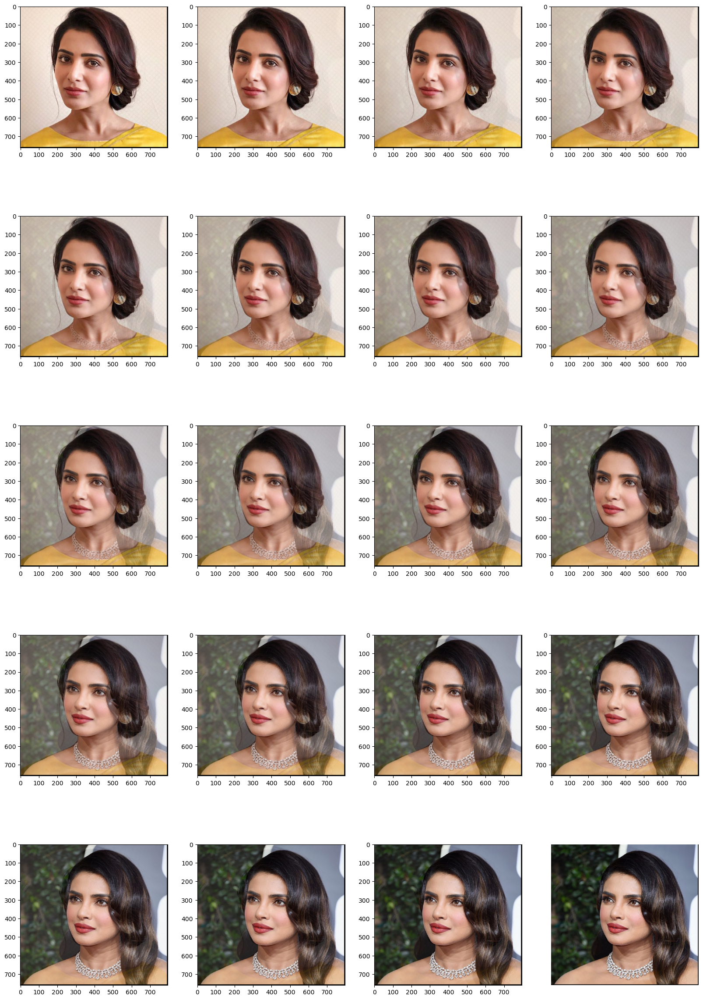

In [39]:
images = np.array(images)
plt.figure(figsize=(20,30))
for i in range(20):
    plt.subplot(5,4,i+1)
    plt.imshow(images[i])

plt.axis('off') 
plt.show()